[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/guiwitz/DSL_CV2_PyTorch/blob/main/notebooks/10-Detections.ipynb)

# Detections

Until now we have seen networks for classification and segmentation. Here we turn our attention towards object detection and instance segmentation. These networks are more complex as they typically require some post-processing. For example the YOLO algorithm breaks an image into a grid of boxes and makes per box predictions which have to be further combined. In this course we don't re-implement these method, but use the opportunity to learn how to use pre-trained models.

In [1]:
# set path containing data folder or use default for Colab (/gdrive/My Drive)
local_folder = "../"
import urllib.request
urllib.request.urlretrieve('https://raw.githubusercontent.com/guiwitz/MLCV/main/notebooks/check_colab.py', 'check_colab.py')
from check_colab import set_datapath
colab, datapath = set_datapath(local_folder)

In [2]:
import torch
import matplotlib.pyplot as plt
import torchvision.transforms.functional as F
import numpy as np

## YOLO

You Look Only Once (YOLO) is a popular algorithm that has the advantage that it can be trained end-to-end i.e. the post-processing linked to object detection is performed in the network and not outside. Such object detection networks are typically trained on the MS-Coco dataset, a large dataset of images annotated by hand. We can find this model with pre-trained weights in different places, notably on the torch hub. From there we can download it using:

In [3]:
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)

Using cache found in /Users/gw18g940/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2022-10-10 Python-3.10.12 torch-2.0.1 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 


We can use it then with both local and remote images:

In [4]:
imgs = ['https://github.com/guiwitz/MLCV/raw/main/supp_data/cars_hydrant.jpg']  # batch of images

In [5]:
results = model(imgs)

The result can be visualized directly:

In [6]:
results.show()

and we also get access to all the detections:

In [7]:
results.pandas().xyxy[0]

,xmin,ymin,xmax,ymax,confidence,class,name
0,2350.910156,2792.896240,3024.000000,3307.576904,0.899107,2,car
1,1811.332764,2724.808350,1969.747925,2844.557129,0.793419,2,car
2,2140.587891,2762.218750,2525.746582,3083.283447,0.775818,2,car
3,347.199738,3227.949707,519.865051,3689.801514,0.451471,10,fire hydrant
4,2131.630615,2761.944092,2297.398193,3026.198486,0.439844,2,car


## Mask RCNN

Mask-RCNN is another segmentation method, slower but more accurate that YOLO. In addition to bounding boxes, the model also provides instance segmentation.

In [8]:
%matplotlib inline

In [9]:
import torchvision
from torchvision.models.detection import MaskRCNN_ResNet50_FPN_Weights

In [10]:
weights =MaskRCNN_ResNet50_FPN_Weights.DEFAULT

model = torchvision.models.detection.maskrcnn_resnet50_fpn(weights=weights)
transform = weights.transforms()

In [11]:
categories = weights.meta['categories']

In [12]:
import imageio.v3 as iio

In [14]:
image = iio.imread(datapath.joinpath('data/woody_bulle.JPG'))

In [15]:
image_tensor = transform(torchvision.transforms.functional.to_pil_image(image))

In [16]:
model.eval()
predictions = model([image_tensor])[0]

In [17]:
selected = predictions['labels'][predictions['scores'] > 0.6]
selected

tensor([17, 17, 28])

In [18]:
categories[17]

'cat'

In [19]:
masks_selected = predictions['masks'][(predictions['scores'] > 0.6)].detach()[:,0]

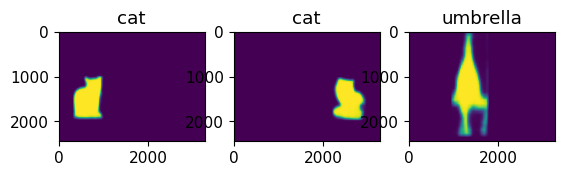

In [20]:
fig, axes = plt.subplots(1,3)
for ind, ax in enumerate(axes.ravel()):
    ax.imshow(masks_selected[ind])
    ax.set_title(categories[selected[ind].numpy()])

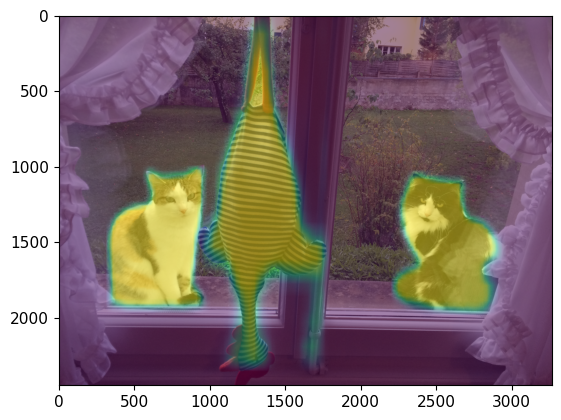

In [21]:
plt.imshow(image)
plt.imshow(masks_selected.sum(axis=0).detach(), alpha = 0.5);

## Visualization tools from torchvision

In [22]:
from torchvision.utils import draw_bounding_boxes
import torchvision.transforms.functional as F

score_threshold = 0.9
result = draw_bounding_boxes(image=(255*image_tensor).to(torch.uint8),
                             boxes=predictions['boxes'][predictions['scores'] > score_threshold],
                             colors=['red','blue', 'yellow'], width=5)

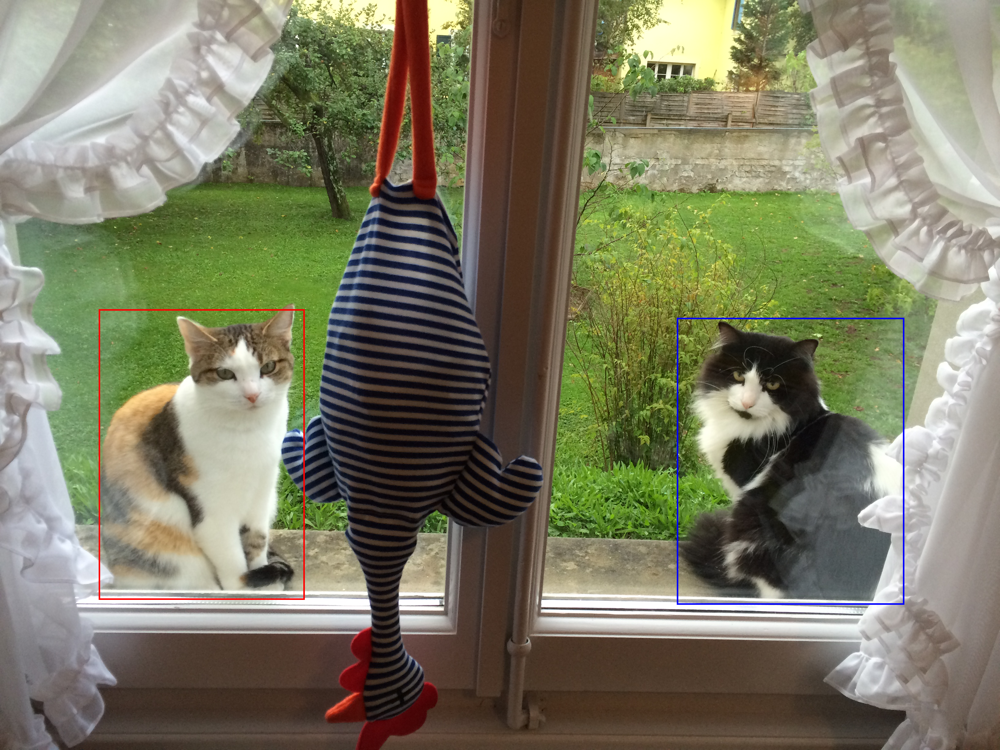

In [23]:
F.to_pil_image(result)

In [24]:
from torchvision.utils import draw_segmentation_masks

In [25]:
masks_selected = predictions['masks'][(predictions['scores'] > 0.6)]

In [26]:
result = draw_segmentation_masks((255*image_tensor).to(torch.uint8), masks=masks_selected[:,0]>0.5);

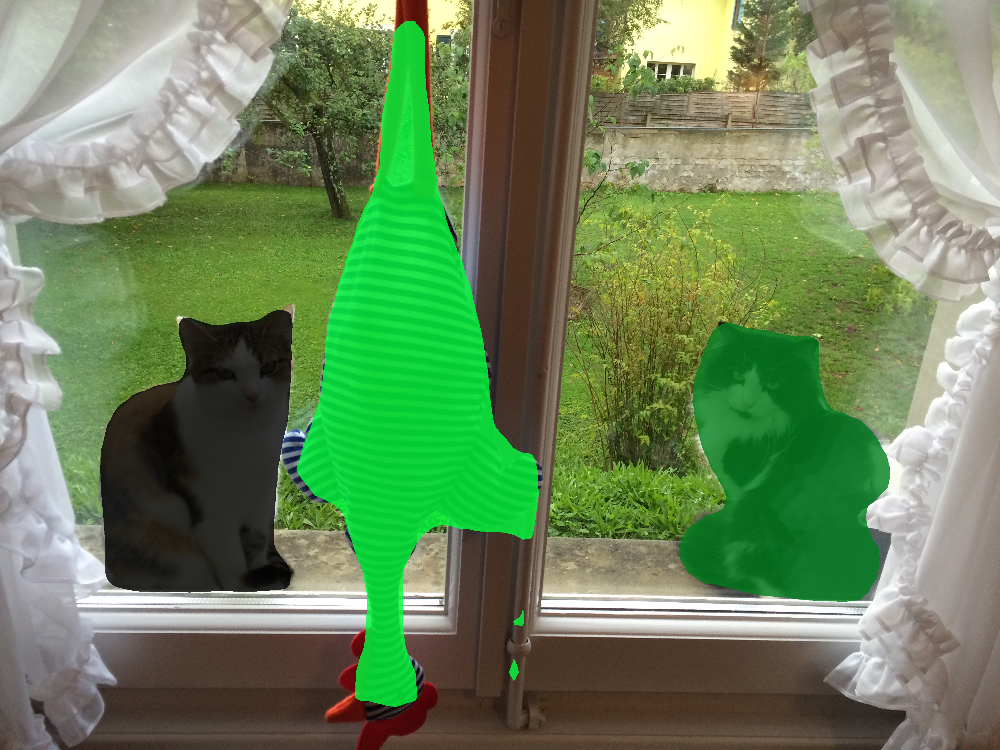

In [27]:
F.to_pil_image(result)

## Key-points for pose estimation

In [28]:
from torchvision.models.detection import KeypointRCNN_ResNet50_FPN_Weights

weights = KeypointRCNN_ResNet50_FPN_Weights.DEFAULT

transform = weights.transforms()

In [29]:
image = iio.imread('https://github.com/guiwitz/MLCV/raw/main/supp_data/ski.jpg')

In [30]:
image_tensor = F.to_pil_image(image)
image_tensor = transform(image_tensor)

In [31]:
model_key = torchvision.models.detection.keypointrcnn_resnet50_fpn(weights=weights)
model_key.eval();

In [32]:
prediction = model_key([image_tensor])[0]

In [33]:
from torchvision.utils import draw_keypoints

In [34]:
keypoints = prediction['keypoints'][prediction['scores'] > 0.8]

In [35]:
res = draw_keypoints((255*image_tensor).to(torch.uint8) , keypoints, colors="blue", radius=10)

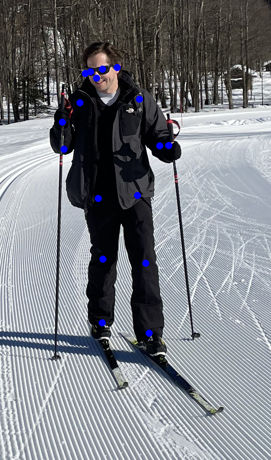

In [36]:
res = F.to_pil_image(res)
res.resize(np.array((res.width/3, res.height/3)).astype(np.uint16))

In [37]:
coco_keypoints = [
    "nose", "left_eye", "right_eye", "left_ear", "right_ear",
    "left_shoulder", "right_shoulder", "left_elbow", "right_elbow",
    "left_wrist", "right_wrist", "left_hip", "right_hip",
    "left_knee", "right_knee", "left_ankle", "right_ankle",
]

connect_skeleton = [
    (0, 1), (0, 2), (1, 3), (2, 4), (0, 5), (0, 6), (5, 7), (6, 8),
    (7, 9), (8, 10), (5, 11), (6, 12), (11, 13), (12, 14), (13, 15), (14, 16)
]

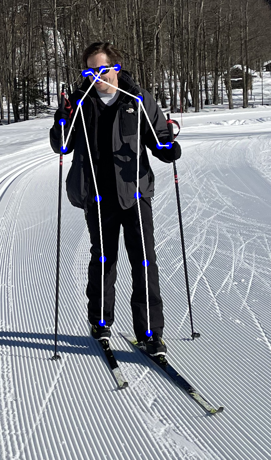

In [38]:
res = draw_keypoints((255*image_tensor).to(torch.uint8), keypoints, connectivity=connect_skeleton, colors="blue", radius=10, width=5)

res = F.to_pil_image(res)
res.resize(np.array((res.width/3, res.height/3)).astype(np.uint16))